<h2 align="center"> Московский Государственный Университет имени М. В. Ломоносова </h2>
<h2 align="center"> Факультет вычислительной математики и кибернетики </h2>
<h3 align="center"> Кафедра Математических Методов Пронозирования </h3>


### Практикум на ЭВМ. Задание №4.
##  Методы восстановления плотности распределений в задаче вычитания фона

Выполнил студент 317 группы *Гарипов Тимур*

---
# Цели задания
В задании рассматривается задача вычитания фона: классификация пикселей видеопоследовательности на принадлежащие
фону и принадлежащие объектам переднего плана. По обучающей выборке необходимо оценить модель фона, чтобы затем для каждого пикселя каждого кадра тестовой видеопоследовательности уметь предсказать вероятность того, что он является фоном.

Требуется протестировать несколько моделей разной сложности и сделать выводы о применимости моделей в разных ситуациях.

---
### 1. EM-алгоритм

В модуле `EM.py` реализован EM-алгоритм для восстановления смеси многомерных нормальных распределений. 

Функция **EM** принимает на вход выборку (матрица X) и количество компонент смеси, результатом работы функции являются: вектор весов компонент `w`, матрицы `mean` и `cov`, содержащие параметры компонентов смеси (математические ожидания и матрицы ковариаций), кроме того возвращается найденное оптимальное значения логарифма правдоподобия выборки.

Функция **EM_best_run** выполняет несколько запусков EM-алгоритма из случайных начальных приближений с выбором наилучшего результата по значению найденного правдоподобия. Необязательный параметр `R` позволяет регулировать количество запусков, все остальные параметры и возвращаемые значения такие же как в функции **EM**

Выше описанные функции имееют следующие дополнительные параметры:

 * `tol` &mdash; точность, регулирующая критерий остановки в EM-алгоритме.  
 * `diag_cov` &mdash; булевский флаг, установка которого позволяет восстановоть смесь нормальных распределений с диагональными матрицами ковариации.
 * `verbose` &mdash; булевский флаг, при установке которого после каждой итерации `EM` алгоритма происходит вывод текущего значения логарифма правдоподобия выборки
 * `seed` (только для функции **EM**) &mdash; seed для выбора начального приближения.


---
### 2. Тестирование реализованного ЕМ-алгоритма на двумерных модельных данных.

Для тестирования генерируются данные из смеси распределений с заданными параметрами, а затем по этим данным восстанавливаются параметры смеси с помощью ЕМ-алгоритма. 

In [64]:
import numpy as np
import EM
import matplotlib.pyplot as plt
from importlib import reload
from JSAnimation import IPython_display
from visualization import make_video
from sklearn.metrics import roc_curve, auc
from matplotlib.colors import rgb_to_hsv
%matplotlib inline
reload(EM)

<module 'EM' from '/home/timgaripov/work/prac/semestr5/04/EM.py'>

In [65]:
reload(EM)
colors = ['red', 'green', 'blue', 'yellow', 'black']
def test(N, K, verbose_param=True, verbose_em=False, gen_seed=None, em_seed=None, best_run=False, diag_cov=False):
    true_w, true_mean, true_cov = EM.generate_params(K, seed=gen_seed, diag_cov=diag_cov)    
    X = EM.generate_test_data(N, K, true_w, true_mean, true_cov, seed=gen_seed)
    if best_run:
        w, mean, cov, log_l = EM.EM_best_run(X, K, verbose=verbose_em, diag_cov=diag_cov)
    else:
        w, mean, cov, log_l = EM.EM(X, K, verbose=verbose_em, seed=em_seed, diag_cov=diag_cov)
    print('Логарифм правдоподобия:', log_l)
    if verbose_param:
        print('true w:')
        print(true_w)
        print('w:')
        print(w)
        
        print('true mean:')
        print(true_mean)
        print('mean:')
        print(mean)
        
        print('true cov:') 
        print(true_cov)        
        print('cov:') 
        print(cov)
        
    fig, ax = plt.subplots(1, 2, sharey=True, figsize=(12, 6))
    ax[0].scatter(X[:, 0], X[:, 1])
    ax[0].set_title('Исходные данные', fontsize=16)
    y = EM.predict(X, K, w, mean, cov)
    for i in range(K):
        ind = np.where(y == i)[0]
        if (i < len(colors)):
            col = colors[i]
        else:
            col = (np.random.rand(), np.random.rand(), np.random.rand())
        ax[1].scatter(X[ind, 0], X[ind, 1], facecolor=col)
    ax[1].set_title('Результат разделения', fontsize=16)
    plt.show()
    

it 1: -5415.731141247582
it 2: -1351.8158836535886
Логарифм правдоподобия: -1351.81588365
true w:
[ 1.]
w:
[ 1.]
true mean:
[[-5.0357955   0.18238889]]
mean:
[[-5.01170057  0.10843478]]
true cov:
[[[ 1.06218106 -0.61960562]
  [-0.61960562  2.65545266]]]
cov:
[[[ 1.24077987 -0.76758047]
  [-0.76758047  2.85633033]]]


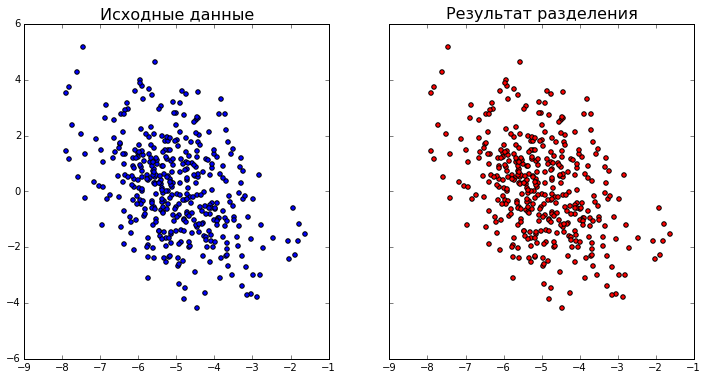

In [19]:
test(400, 1, verbose_em=True, gen_seed=81)

it 1: -14782.9801604159
it 2: -4411.017097620268
it 3: -4072.2365272182
it 4: -3701.365659163671
it 5: -3644.6548836613215
it 6: -3595.517441003938
it 7: -3546.467232384037
it 8: -3470.577309480142
it 9: -3413.22215419054
it 10: -3412.640511403861
Логарифм правдоподобия: -3412.6405114
true w:
[ 0.21428571  0.5         0.28571429]
w:
[ 0.30299992  0.476       0.22100008]
true mean:
[[-2.03911489  4.75990811]
 [-6.35016539 -6.49096488]
 [ 0.63102748  0.63655174]]
mean:
[[ 0.57359064  0.58431076]
 [-6.40245578 -6.50337151]
 [-2.01289588  4.78678876]]
true cov:
[[[ 1.89886359  0.28482954]
  [ 0.28482954  0.4747159 ]]

 [[ 1.42204702  0.21330705]
  [ 0.21330705  0.35551176]]

 [[ 0.84591783  0.12688767]
  [ 0.12688767  0.21147946]]]
cov:
[[[ 0.95581609  0.13852579]
  [ 0.13852579  0.19567848]]

 [[ 1.52325554  0.18721224]
  [ 0.18721224  0.32536978]]

 [[ 2.07186185  0.31161136]
  [ 0.31161136  0.46154955]]]


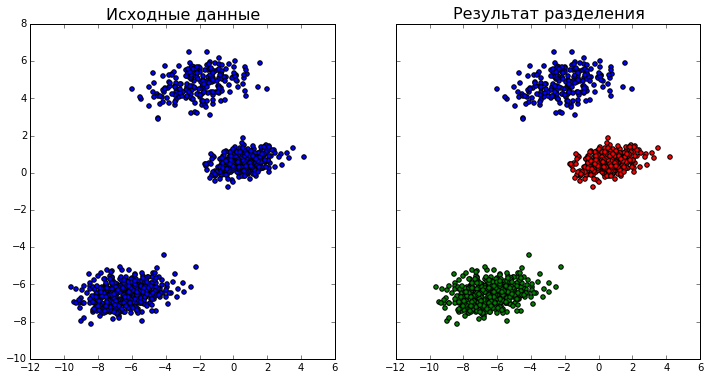

In [66]:
test(1000, 3, verbose_em=True, gen_seed=123, em_seed=167)

it 1: -54354.795935925365
it 2: -13744.997724774797
it 3: -13528.471924437597
it 4: -13493.309005121877
it 5: -13472.931350018074
it 6: -13439.931767217719
it 7: -13368.531391194067
it 8: -13230.746569134759
it 9: -13088.665883810772
it 10: -12956.289167541054
it 11: -12808.65371506632
it 12: -12560.418463244834
it 13: -12056.93188434516
it 14: -11850.85254502883
it 15: -11850.840860124108
Логарифм правдоподобия: -11850.8408601
true w:
[ 0.21428571  0.14285714  0.28571429  0.35714286]
w:
[ 0.2143318   0.36499994  0.28299869  0.13766957]
true mean:
[[ 3.53400038  1.09288786]
 [-6.21224207 -6.74318858]
 [ 1.57529656 -6.48414429]
 [ 8.30683348 -9.34728384]]
mean:
[[ 3.49939067  1.08977318]
 [ 8.29980824 -9.35781687]
 [ 1.58341692 -6.49871198]
 [-6.28781383 -6.68725461]]
true cov:
[[[ 1.70837007  0.25625551]
  [ 0.25625551  0.42709252]]

 [[ 1.16463823  0.17469573]
  [ 0.17469573  0.29115956]]

 [[ 0.71036781 -0.41438122]
  [-0.41438122  1.77591953]]

 [[ 0.51327035 -0.2994077 ]
  [-0.2994

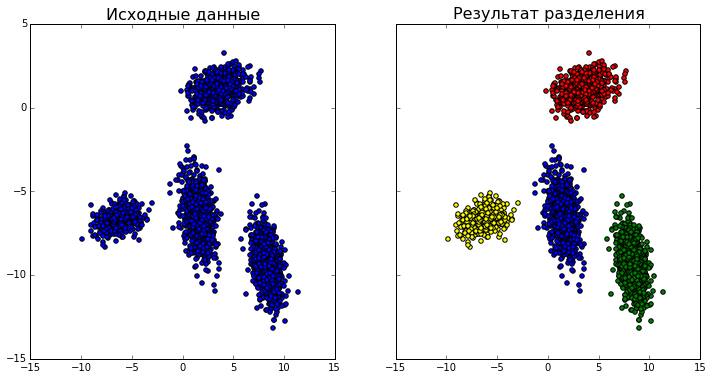

In [5]:
test(3000, 4, verbose_em=True, gen_seed=153, em_seed=1837, best_run=False)

it 1: -10291.392853324285
it 2: -2577.79044315544
it 3: -2529.9450480391138
it 4: -2510.8962893281437
it 5: -2504.894690632943
it 6: -2497.6306123603576
it 7: -2487.908997168176
it 8: -2474.687615152667
it 9: -2456.7439226913148
it 10: -2434.8836639768438
it 11: -2410.9774668401133
it 12: -2399.9288630677243
it 13: -2394.4119095491114
it 14: -2390.8534270554105
it 15: -2383.628463666101
it 16: -2372.5205704235327
it 17: -2364.8642536543116
it 18: -2357.7905431661816
it 19: -2350.9121370490507
it 20: -2341.4922001034734
it 21: -2327.8177625479984
it 22: -2308.804323288685
it 23: -2280.2456632046246
it 24: -2235.0449768101257
it 25: -2179.2425900081316
it 26: -2116.7842290301855
it 27: -2033.8846779353016
it 28: -2028.6557579355533
it 29: -2028.655732143458
it 30: -2028.6557320386091
Логарифм правдоподобия: -2028.65573204
true w:
[ 0.33333333  0.22222222  0.16666667  0.11111111  0.16666667]
w:
[ 0.15793066  0.22606934  0.148       0.35999999  0.108     ]
true mean:
[[-7.30695647  7.15133

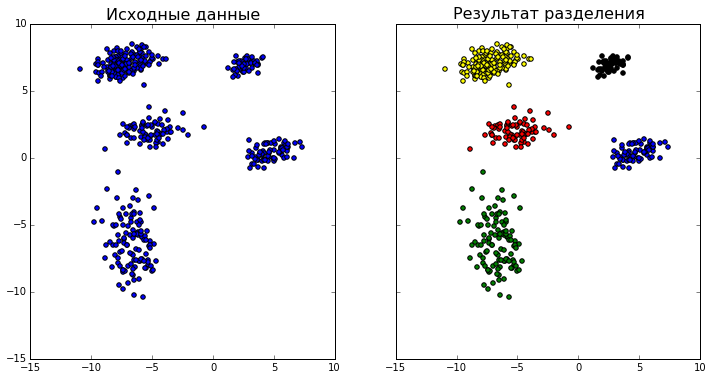

In [6]:
test(500, 5, verbose_em=True, gen_seed=1153, em_seed=1837, best_run=False)

---
Ниже приведен пример данных, результат работы EM-алгоритма на которых зависит от начального приближения.

Логарифм правдоподобия: -19264.4681009


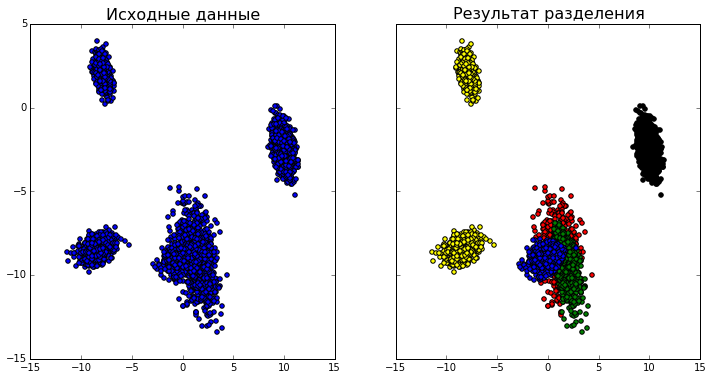

In [7]:
test(5000, 5, verbose_param=False, verbose_em=False, gen_seed=175461, em_seed=1837)

Логарифм правдоподобия: -23250.78678


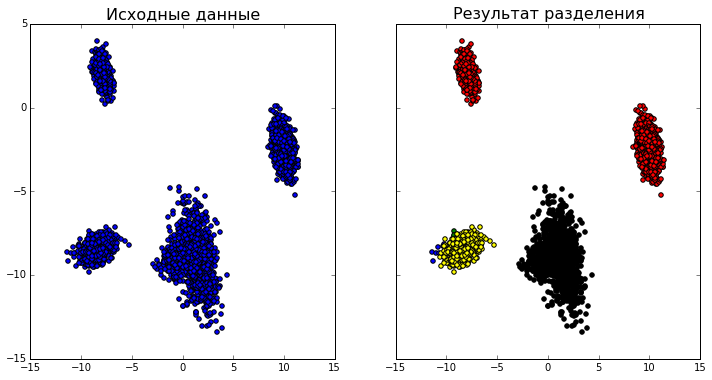

In [8]:
test(5000, 5, verbose_param=False, verbose_em=False, gen_seed=175461, em_seed=1)

Логарифм правдоподобия: -16681.5030999


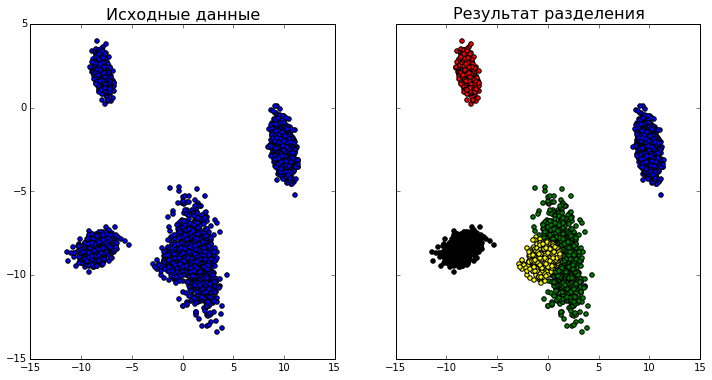

In [9]:
test(5000, 5, verbose_param=False, verbose_em=False, gen_seed=175461, em_seed=865)

Логарифм правдоподобия: -16681.503099


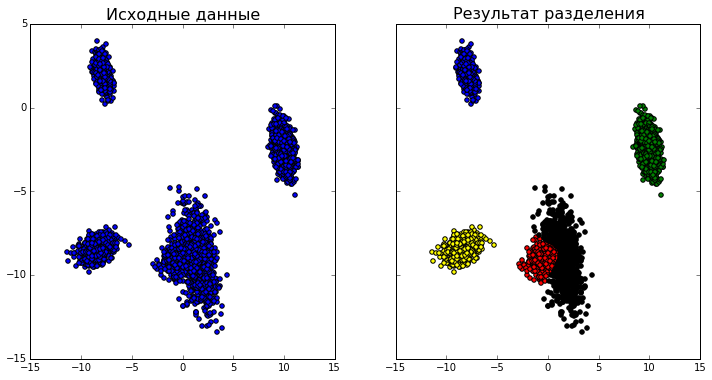

In [10]:
test(5000, 5, verbose_param=False, verbose_em=False, gen_seed=175461, best_run=True)

Выбор лучшего запуска ЕМ-алгоритма действительно позволяет решить проблему зависимости результата от начального приближения.

---
Далее проведем тестирование разделения смесей нормальных распределений с диагональными матрицами ковариаций.

it 1: -17233.856972973917
it 2: -4838.488675612068
it 3: -4521.5834031876875
it 4: -4479.937327437309
it 5: -4460.758126614778
it 6: -4446.552419032377
it 7: -4438.220478037993
it 8: -4433.903274151491
it 9: -4431.535641448844
it 10: -4430.121565146358
it 11: -4429.238207846785
it 12: -4428.673777528568
it 13: -4428.306722605446
it 14: -4428.063713211004
it 15: -4427.899901198028
it 16: -4427.787618675323
it 17: -4427.709560739089
it 18: -4427.6546905915675
it 19: -4427.615806365871
it 20: -4427.588098473231
it 21: -4427.568286652405
it 22: -4427.554094238504
it 23: -4427.543919750408
it 24: -4427.536625806472
it 25: -4427.531399513521
it 26: -4427.527657706496
it 27: -4427.524981242367
it 28: -4427.52306869767
it 29: -4427.521703370594
it 30: -4427.520729596511
it 31: -4427.5200356804
it 32: -4427.519541576615
it 33: -4427.519189993284
it 34: -4427.518939974469
it 35: -4427.518762275562
it 36: -4427.518636036112
it 37: -4427.518546390066
it 38: -4427.518482751958
it 39: -4427.51843758

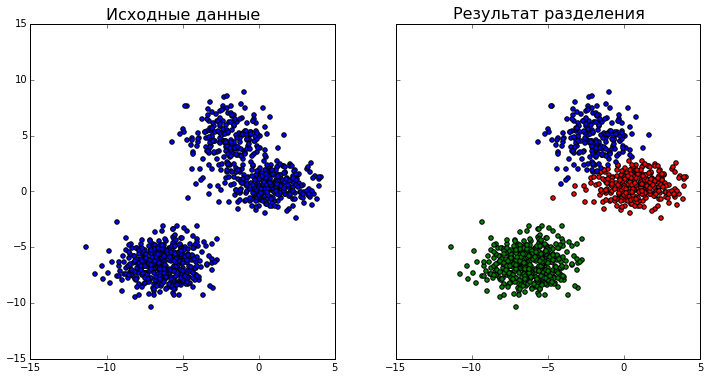

In [11]:
test(1000, 3, verbose_em=True, gen_seed=123, em_seed=167, diag_cov=True)

it 1: -52715.77138428787
it 2: -14470.156068376275
it 3: -14309.789151171368
it 4: -14167.8365336826
it 5: -14020.195957864855
it 6: -13882.130078532899
it 7: -13799.520234903044
it 8: -13788.203718861867
it 9: -13787.765879050723
it 10: -13787.75216033095
it 11: -13787.751728203853
it 12: -13787.751714562215
it 13: -13787.751714131564
Логарифм правдоподобия: -13787.7517141
true w:
[ 0.2173913   0.2173913   0.39130435  0.17391304]
w:
[ 0.20579166  0.392       0.18007873  0.22212961]
true mean:
[[-0.11832121  7.42506764]
 [ 6.39895724 -2.35370094]
 [-8.43917502 -9.02822378]
 [ 5.13099993  4.60424471]]
mean:
[[ 6.43958037 -2.36730545]
 [-8.52054837 -9.12477329]
 [ 5.18059468  4.56745707]
 [-0.09637434  7.41325212]]
true cov:
[[[ 1.10483097  0.        ]
  [ 0.          1.56150841]]

 [[ 1.53208219  0.        ]
  [ 0.          0.91887563]]

 [[ 1.90110362  0.        ]
  [ 0.          2.13279809]]

 [[ 1.20542274  0.        ]
  [ 0.          1.6123469 ]]]
cov:
[[[ 1.55580745  0.        ]
  

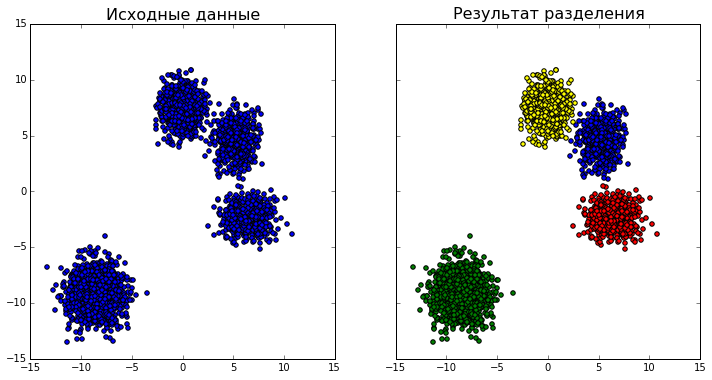

In [12]:
test(3000, 4, verbose_em=True, gen_seed=12783, em_seed=167, diag_cov=True)

На всех проведенных тестах реализованный ЕМ-алгоритм успешно восстановил смесь распределений. Выведенные значения позволяют убедиться в том, что во время работы ЕМ-алгоритма правдоподобие монотонно неубывает.

---
### 3.  Оценка модели фона с помощью одномерной гауссианы

In [8]:
"""
from glob import glob 
from matplotlib.image import imread
names = sorted(glob(r'./data/pedestrians/input/*.jpg'))
images = np.zeros((len(names), 240, 360, 3), dtype=np.float32)
gs = np.zeros((len(names), 240, 360), dtype=np.float32)
hsv = np.zeros((len(names), 240, 360, 3), dtype=np.float32)
for i, s in enumerate(names):
    images[i] = imread(s)
    gs[i] = np.sum(images[i] * np.array([0.2126, 0.7152, 0.0722]).astype(np.float32), axis=2).astype(np.float32)
    hsv[i] = rgb_to_hsv(images[i])
    print('.', end='')

motion = np.zeros((len(names), 240, 360), dtype=np.bool)
static = np.zeros((len(names), 240, 360), dtype=np.bool)
for i, s in enumerate(sorted(glob(r'./data/pedestrians/groundtruth/*.png'))): 
    img = imread(s)
    static[i] = (img == 0).all(axis=2)
    motion[i] = (img == 1).all(axis=2)
"""

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

In [9]:
# np.savez('pedestrians.npz', images=images, gs=gs, motion=motion, static=static, hsv=hsv)

In [2]:
f = np.load('pedestrians.npz')
images = f['images']
#gs = f['gs']
motion = f['motion']
static = f['static']
hsv = f['hsv']

In [3]:
train_ind = np.arange(300)
test_ind = np.arange(300, images.shape[0])

In [3]:
train_img = gs[train_ind]
test_img = gs[test_ind]

In [4]:
w, h = gs[0].shape
mean = np.zeros((w, h), dtype='float32')
std = np.zeros((w, h), dtype='float32')
for x in range(w):
    for y in range(h):
        X = train_img[:, x, y]
        _, m, c, _ = EM.EM(X[:, np.newaxis], 1)
        mean[x, y] = m
        std[x, y] = np.sqrt(c)

In [5]:
p = np.abs(test_img - mean[np.newaxis, :, :]) / (1.0 * np.maximum(std, 3.0))[np.newaxis, :, :]
y = p > 7.0

Для классификации был выбран порог $6 \sigma$. Порог выбирался так, чтобы сбалансировать количество ошибок 1 и 2 рода.

График, изображенный ниже показывает количество ошибок 1 рода (FP) и 2 рода (FN) для каждого кадра. 

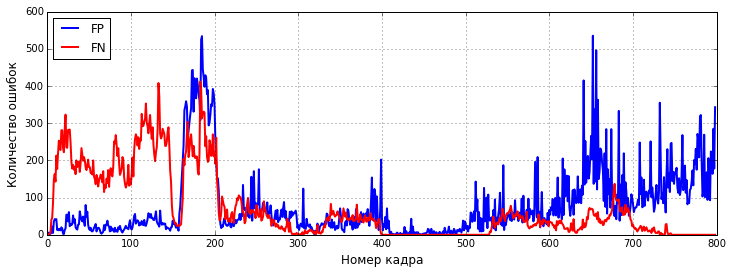

In [35]:
FP = np.sum(np.logical_and(static[test_ind], y), axis=(1, 2))
FN = np.sum(np.logical_and(motion[test_ind], np.logical_not(y)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN, 'r-', linewidth=2, label='FN')
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.legend(loc=2)
plt.grid()
plt.show()

Как видно данный метод допускает достаточное количество ошибок 1 и 2 рода. В конце видео последовательности количество ошибок 1 рода заместно возрастает, скорее всего это связано с изменением освещения. 

In [36]:
msk = np.logical_or(motion, static)[test_ind]
fpr, tpr, _ = roc_curve(motion[test_ind][msk], p[msk])

На следующем графике изображена ROC-кривая для исследуемого метода.

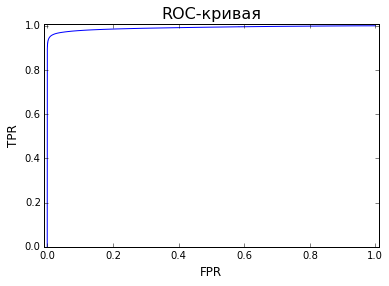

AUC-ROC: 0.990888133309


In [37]:
plt.plot(fpr, tpr)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr, tpr))

Размеченную видеопоследовательность можно найти в файле `one_gaussian.gif`

/usr/lib/python3/dist-packages/matplotlib/animation.py:727: UserWarning: MovieWriter ffmpeg unavailable
  warnings.warn("MovieWriter %s unavailable" % writer)


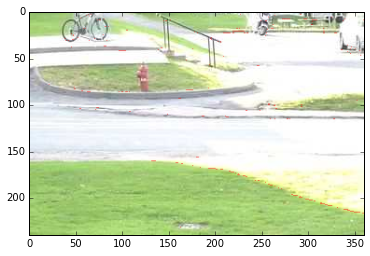

In [6]:
video = make_video(images[test_ind], y)
video().save('one_gaussian.gif')
del video

---
### 4. Оценка модели фона на основе адаптивной одномерной гауссианы

In [52]:
rho = 1e-3
cur_mean = mean.copy()
cur_std = std.copy()
y_adapt = np.zeros((len(test_ind), w, h), dtype=np.bool)
p_adapt = np.zeros((len(test_ind), w, h), dtype=np.float32)
for frame in range(len(test_ind)):
    p_adapt[frame] = (np.abs(test_img[frame] - cur_mean[ :, :]) / 
                     (1.0 * np.maximum(cur_std, 3.0))[:, :])
    y_adapt[frame] = (p_adapt[frame] > 7.0)
    msk = np.logical_not(y_adapt[frame])
    cur_mean[msk] = rho * test_img[frame][msk] + (1.0 - rho) * cur_mean[msk]
    cur_std[msk] = np.sqrt(rho * (test_img[frame][msk] - cur_mean[msk]) ** 2 + (1.0 - rho) * cur_std[msk] ** 2)
    print('.', end='')


...............................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

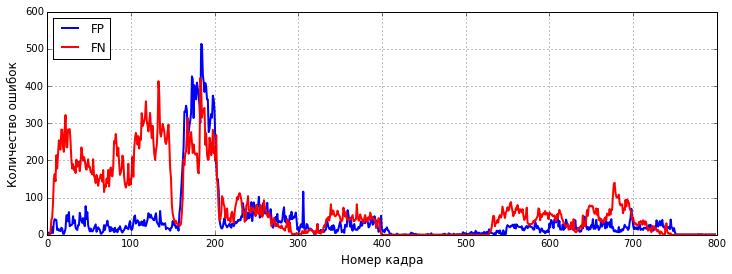

In [53]:
FP_adapt = np.sum(np.logical_and(static[test_ind], y_adapt), axis=(1, 2))
FN_adapt = np.sum(np.logical_and(motion[test_ind], np.logical_not(y_adapt)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP_adapt, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN_adapt, 'r-', linewidth=2, label='FN')
plt.legend(loc=2)
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.grid()
plt.show()

Как видно из графика подобром оптимального значения параметра $\rho$ удалось решить проблему дрейфа фона. На последних кадрах значительно уменьшилось количество ошибок 1 рода, а количество ошибка на первых кадрах не изменилось.

In [54]:
msk = np.logical_or(motion, static)[test_ind]
fpr_adapt, tpr_adapt, _ = roc_curve(motion[test_ind][msk], p_adapt[msk])

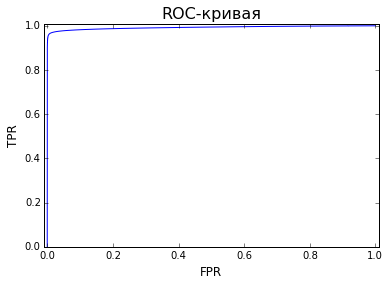

AUC-ROC: 0.992249490712


In [57]:
plt.plot(fpr_adapt, tpr_adapt)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr_adapt, tpr_adapt))

Кроме того, использование адаптивной гауссианы позволило увеличить значение AUC-ROC.

/usr/lib/python3/dist-packages/matplotlib/animation.py:727: UserWarning: MovieWriter ffmpeg unavailable
  warnings.warn("MovieWriter %s unavailable" % writer)


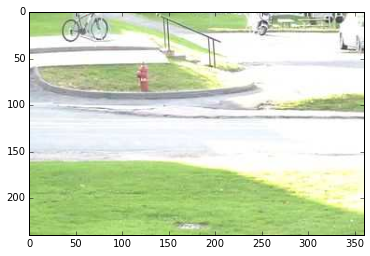

In [58]:
video = make_video(images[test_ind], y_adapt)
video().save('adaptive_gaussian.gif')
del video

### 5. Оценка модели фона с помощью многомерной гауссианы в цветовых пространствах RGB и HSV

### Цветовое пространство RBG

In [ ]:
train_img_3d = images[train_ind]
test_img_3d = images[test_ind]
w, h = gs[0].shape

In [43]:
mean_3d = np.zeros((w, h, 3), dtype=np.float32)
cov_3d = np.zeros((w, h, 3, 3), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = train_img_3d[:, x, y, :]                
        _, m, c, _ = EM.EM(X, 1)
        
        mean_3d[x, y, :] = m
        cov_3d[x, y, :, :] = c
    print('.', end='')

................................................................................................................................................................................................................................................

In [96]:
cov_3d[:, :, np.arange(3), np.arange(3)] = np.maximum(cov_3d[:, :, np.arange(3), np.arange(3)], 12)

In [97]:
p_3d = np.zeros((test_img.shape[0], w, h), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = test_img_3d[:, x, y, :]
        p_3d[:, x, y] = -EM.logpdf(X, mean_3d[x, y], cov_3d[x, y])
    print('.', end='')

................................................................................................................................................................................................................................................

In [103]:
y_3d = p_3d > 150

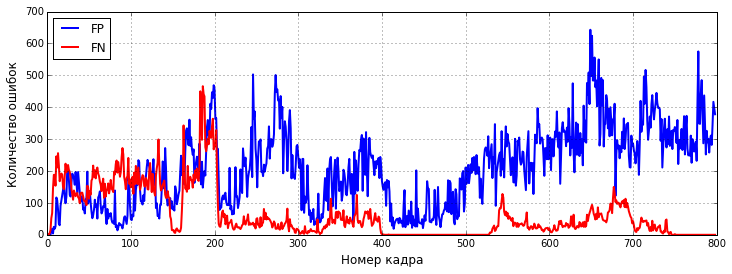

In [104]:
FP_3d = np.sum(np.logical_and(static[test_ind], y_3d), axis=(1, 2))
FN_3d = np.sum(np.logical_and(motion[test_ind], np.logical_not(y_3d)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP_3d, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN_3d, 'r-', linewidth=2, label='FN')
plt.legend(loc=2)
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.grid()
plt.show()

In [105]:
msk = np.logical_or(motion, static)[test_ind]
fpr_3d, tpr_3d, _ = roc_curve(motion[test_ind][msk], p_3d[msk])

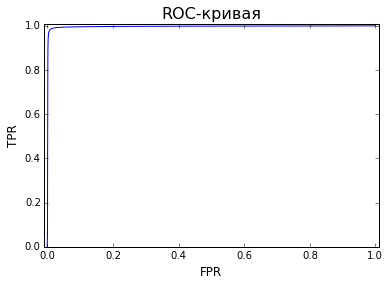

AUC-ROC: 0.996432243493


In [106]:
plt.plot(fpr_3d, tpr_3d)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr_3d, tpr_3d))

/usr/lib/python3/dist-packages/matplotlib/animation.py:727: UserWarning: MovieWriter ffmpeg unavailable
  warnings.warn("MovieWriter %s unavailable" % writer)


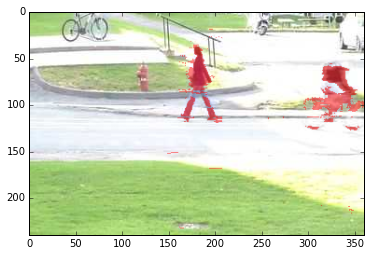

In [107]:
video = make_video(images[test_ind[:200]], y_3d[:200])
video().save('3d_gaussian_rgb.gif')
del video

### Аналогичная модель для гауссианы с диагональной матрицей ковариаций

In [5]:
mean_3d_diag = np.zeros((w, h, 3), dtype=np.float32)
cov_3d_diag = np.zeros((w, h, 3, 3), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = train_img_3d[:, x, y, :]                
        _, m, c, _ = EM.EM(X, 1, diag_cov=True)
        
        mean_3d_diag[x, y, :] = m
        cov_3d_diag[x, y, :, :] = c
    print('.', end='')

................................................................................................................................................................................................................................................

In [23]:
cov_3d_diag[:, :, np.arange(3), np.arange(3)] = np.maximum(cov_3d_diag[:, :, np.arange(3), np.arange(3)], 7)

In [24]:
p_3d_diag = np.zeros((test_img.shape[0], w, h), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = test_img_3d[:, x, y, :]
        p_3d_diag[:, x, y] = -EM.logpdf(X, mean_3d_diag[x, y], cov_3d_diag[x, y])
    print('.', end='')

................................................................................................................................................................................................................................................

In [31]:
y_3d_diag = p_3d_diag > 120

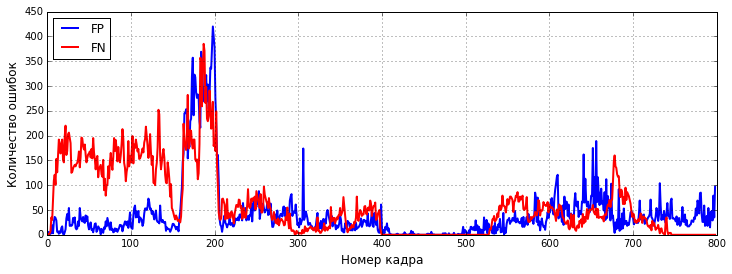

In [32]:
FP_3d_diag = np.sum(np.logical_and(static[test_ind], y_3d_diag), axis=(1, 2))
FN_3d_diag = np.sum(np.logical_and(motion[test_ind], np.logical_not(y_3d_diag)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP_3d_diag, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN_3d_diag, 'r-', linewidth=2, label='FN')
plt.legend(loc=2)
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.grid()
plt.show()

In [33]:
msk = np.logical_or(motion, static)[test_ind]
fpr_3d_diag, tpr_3d_diag, _ = roc_curve(motion[test_ind][msk], p_3d_diag[msk])

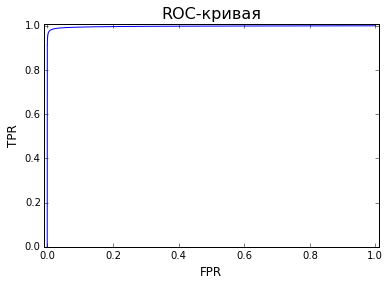

AUC-ROC: 0.997436185394


In [34]:
plt.plot(fpr_3d_diag, tpr_3d_diag)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr_3d_diag, tpr_3d_diag))

/usr/lib/python3/dist-packages/matplotlib/animation.py:727: UserWarning: MovieWriter ffmpeg unavailable
  warnings.warn("MovieWriter %s unavailable" % writer)


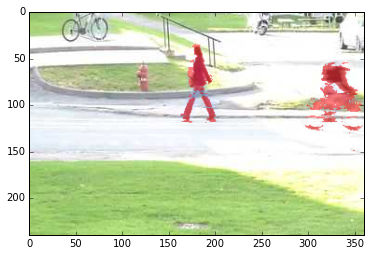

In [35]:
video = make_video(images[test_ind[:200]], y_3d_diag[:200])
video().save('3d_diag_gaussian_rgb.gif')
del video

---
### Цветовое пространство HSV

In [5]:
train_img_3d = hsv[train_ind]
test_img_3d = hsv[test_ind]
w, h = hsv.shape[1:3]

In [14]:
mean_3d_hsv = np.zeros((w, h, 3), dtype=np.float32)
cov_3d_hsv = np.zeros((w, h, 3, 3), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = train_img_3d[:, x, y, :]                
        _, m, c, _ = EM.EM(X, 1)
        
        mean_3d_hsv[x, y, :] = m
        cov_3d_hsv[x, y, :, :] = c
    print('.', end='')

................................................................................................................................................................................................................................................

In [15]:
cov_3d_hsv[:, :, np.arange(3), np.arange(3)] = np.maximum(cov_3d_hsv[:, :, np.arange(3), np.arange(3)], [0.06, 0.06, 6])

In [16]:
p_3d_hsv = np.zeros((test_img_3d.shape[0], w, h), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = test_img_3d[:, x, y, :]
        p_3d_hsv[:, x, y] = -EM.logpdf(X, mean_3d_hsv[x, y], cov_3d_hsv[x, y])
    print('.', end='')

................................................................................................................................................................................................................................................

In [17]:
y_3d_hsv = p_3d_hsv > 35

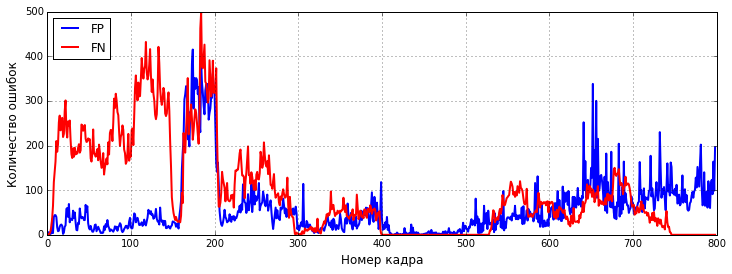

In [18]:
FP_3d_hsv = np.sum(np.logical_and(static[test_ind], y_3d_hsv), axis=(1, 2))
FN_3d_hsv = np.sum(np.logical_and(motion[test_ind], np.logical_not(y_3d_hsv)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP_3d_hsv, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN_3d_hsv, 'r-', linewidth=2, label='FN')
plt.legend(loc=2)
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.grid()
plt.show()

In [20]:
msk = np.logical_or(motion, static)[test_ind]
fpr_3d_hsv, tpr_3d_hsv, _ = roc_curve(motion[test_ind][msk], p_3d_hsv[msk])

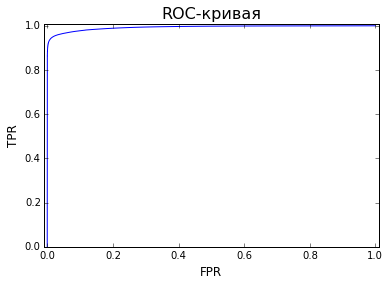

AUC-ROC: 0.992826079518


In [21]:
plt.plot(fpr_3d_hsv, tpr_3d_hsv)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr_3d_hsv, tpr_3d_hsv))

/usr/lib/python3/dist-packages/matplotlib/animation.py:727: UserWarning: MovieWriter ffmpeg unavailable
  warnings.warn("MovieWriter %s unavailable" % writer)


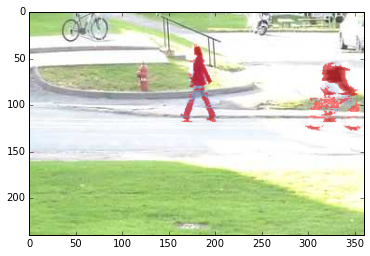

In [53]:
video = make_video(images[test_ind[:200]], y_3d_hsv[:200])
video().save('3d_gaussian_hsv.gif')
del video

### Аналогичная модель для гауссианы с диагональной матрицей ковариаций

In [4]:
train_img_3d = hsv[train_ind]
test_img_3d = hsv[test_ind]
w, h = hsv.shape[1:3]

In [5]:
mean_3d_hsv_diag = np.zeros((w, h, 3), dtype=np.float32)
cov_3d_hsv_diag = np.zeros((w, h, 3, 3), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = train_img_3d[:, x, y, :]                
        _, m, c, _ = EM.EM(X, 1, diag_cov=True)
        
        mean_3d_hsv_diag[x, y, :] = m
        cov_3d_hsv_diag[x, y, :, :] = c
    print('.', end='')

................................................................................................................................................................................................................................................

In [20]:
cov_3d_hsv_diag[:, :, np.arange(3), np.arange(3)] = np.maximum(cov_3d_hsv_diag[:, :, np.arange(3), np.arange(3)], 
                                                               [0.06, 0.06, 6])

In [21]:
p_3d_hsv_diag = np.zeros((test_img_3d.shape[0], w, h), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = test_img_3d[:, x, y, :]
        p_3d_hsv_diag[:, x, y] = -EM.logpdf(X, mean_3d_hsv_diag[x, y], cov_3d_hsv_diag[x, y], diag_cov=True)
    print('.', end='')

................................................................................................................................................................................................................................................

In [22]:
y_3d_hsv_diag = p_3d_hsv_diag > 35

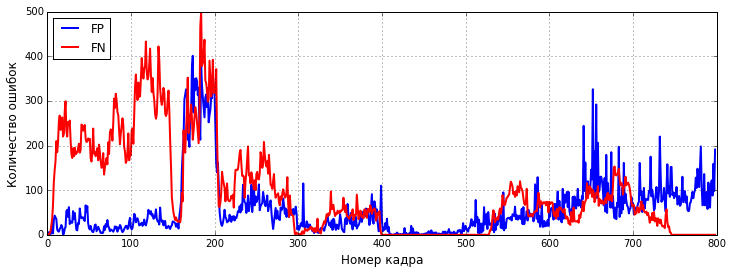

In [23]:
FP_3d_hsv_diag = np.sum(np.logical_and(static[test_ind], y_3d_hsv_diag), axis=(1, 2))
FN_3d_hsv_diag = np.sum(np.logical_and(motion[test_ind], np.logical_not(y_3d_hsv_diag)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP_3d_hsv_diag, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN_3d_hsv_diag, 'r-', linewidth=2, label='FN')
plt.legend(loc=2)
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.grid()
plt.show()

In [25]:
msk = np.logical_or(motion, static)[test_ind]
fpr_3d_hsv_diag, tpr_3d_hsv_diag, _ = roc_curve(motion[test_ind][msk], p_3d_hsv_diag[msk])

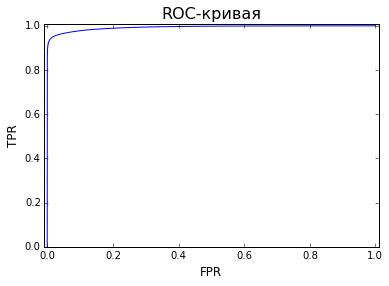

AUC-ROC: 0.992805009433


In [26]:
plt.plot(fpr_3d_hsv_diag, tpr_3d_hsv_diag)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr_3d_hsv_diag, tpr_3d_hsv_diag))

Проведенные эксперименты позволяют сделать следующие выводы:
 
* Использование трехмерной гауссианы даёт прирост качества по метрике AUC-ROC
* В цвеотовом пространстве RGB использование диагональной матрицы ковариаций позволяет улулчшить результаты, в то же время в пространстве HSV этот шаг не имеет никакого эффекта (видимо из-за того, что каналы в HSV коррелируют меньше).
* Ошибки для модели с трехмерной гауссианой незначительно отличаются от ошибок модели с одномерной гауссианой.
* В пространстве RGB удается добиться лучших результатов, чем в простанстве HSV.

### 6.  Разделение смеси 3 трёхмерных гауссиан для вычитания фона в последовательности traffic


In [2]:
from glob import glob 
from matplotlib.image import imread
names = sorted(glob(r'./data/traffic/input/*.jpg'))
images = np.zeros((len(names), 240, 320, 3), dtype=np.float32)
for i, s in enumerate(names):
    if i < 580:
        continue
    images[i] = imread(s)
    print('.', end='')

motion = np.zeros((len(names), 240, 320), dtype=np.bool)
static = np.zeros((len(names), 240, 320), dtype=np.bool)
for i, s in enumerate(sorted(glob(r'./data/traffic/groundtruth/*.png'))): 
    if i < 580:
        continue
    img = imread(s)
    static[i] = (img == 0).all(axis=2)
    motion[i] = (img == 1).all(axis=2)

..............................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

In [3]:
train_ind = np.concatenate((np.arange(580, 722), np.arange(751, 950)))
test_ind = np.arange(999, 1569)

In [4]:
train_img = images[train_ind]
test_img = images[test_ind]

In [75]:
reload(EM)
w, h = train_img.shape[1:3]
alpha_3d_diag = np.zeros((w, h, 3), dtype=np.float)
mean_3d_diag = np.zeros((w, h, 3, 3), dtype=np.float32)
cov_3d_diag = np.zeros((w, h, 3, 3, 3), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = train_img[:, x, y, :]                
        alpha, m, c, _ = EM.EM(X, 3, diag_cov=True, tol=5e-2, seed=3234)
        alpha_3d_diag[x, y, :] = alpha
        mean_3d_diag[x, y, :, :] = m
        cov_3d_diag[x, y, :, :, :] = c        
    print('.', end='')

................................................................................................................................................................................................................................................

In [77]:
# np.savez('traffic_res', alpha_3d_diag=alpha_3d_diag, mean_3d_diag=mean_3d_diag, cov_3d_diag=cov_3d_diag)

In [142]:
cov_3d_diag[:, :, :, np.arange(3), np.arange(3)] = np.maximum(cov_3d_diag[:, :, :, np.arange(3), np.arange(3)], 10)

In [143]:
p_3d_diag = np.zeros((test_img.shape[0], w, h), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = test_img[:, x, y, :]
        p1 = -EM.logpdf(X, mean_3d_diag[x, y, 0], cov_3d_diag[x, y, 0])
        p2 = -EM.logpdf(X, mean_3d_diag[x, y, 1], cov_3d_diag[x, y, 1])
        p3 = -EM.logpdf(X, mean_3d_diag[x, y, 2], cov_3d_diag[x, y, 2])
        f = np.maximum(p1, p2, p3)
        
        p_3d_diag[:, x, y] = f + np.log(alpha_3d_diag[x, y, 0] * np.exp(p1 - f) + 
                                        alpha_3d_diag[x, y, 1] * np.exp(p2 - f) + 
                                        alpha_3d_diag[x, y, 2] * np.exp(p3 - f))
    print('.', end='')

................................................................................................................................................................................................................................................

In [148]:
y_3d_diag = p_3d_diag > 180

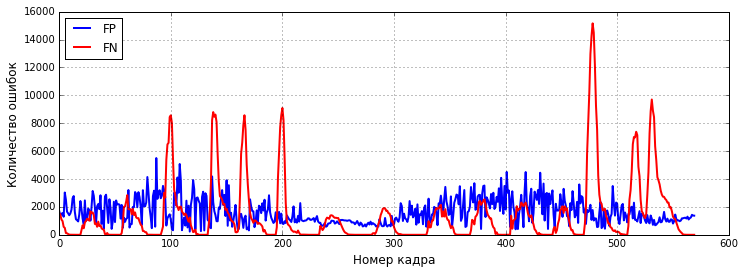

In [149]:
FP_3d_diag = np.sum(np.logical_and(static[test_ind], y_3d_diag), axis=(1, 2))
FN_3d_diag = np.sum(np.logical_and(motion[test_ind], np.logical_not(y_3d_diag)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP_3d_diag, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN_3d_diag, 'r-', linewidth=2, label='FN')
plt.legend(loc=2)
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.grid()
plt.show()

In [150]:
msk = np.logical_or(motion, static)[test_ind]
fpr_3d_diag, tpr_3d_diag, _ = roc_curve(motion[test_ind][msk], p_3d_diag[msk])

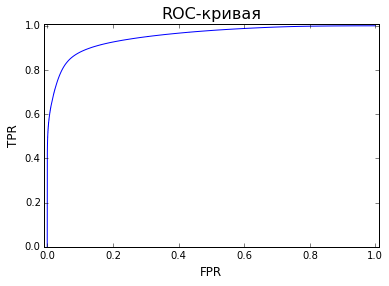

AUC-ROC: 0.952664547134


In [151]:
plt.plot(fpr_3d_diag, tpr_3d_diag)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr_3d_diag, tpr_3d_diag))


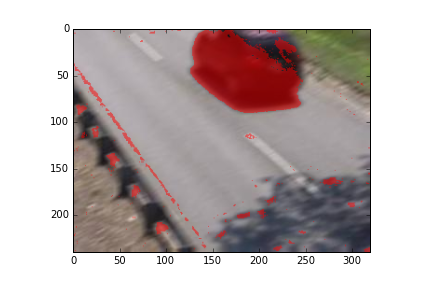
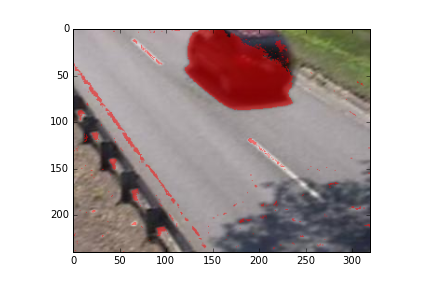
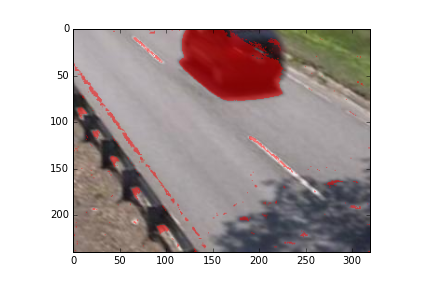
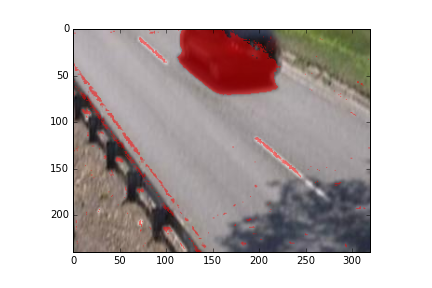
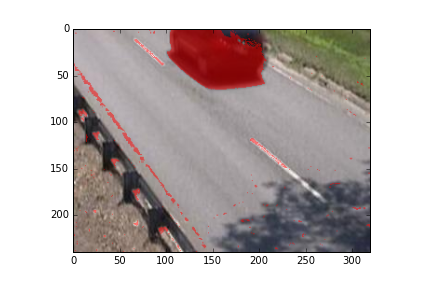
...
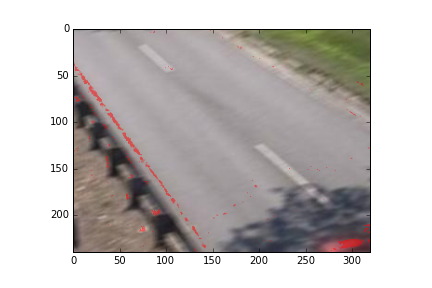
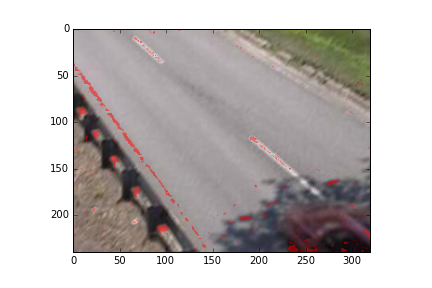
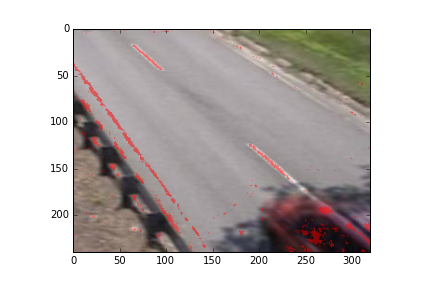
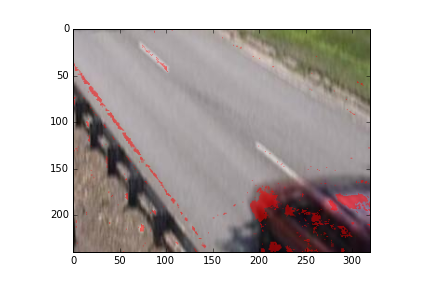
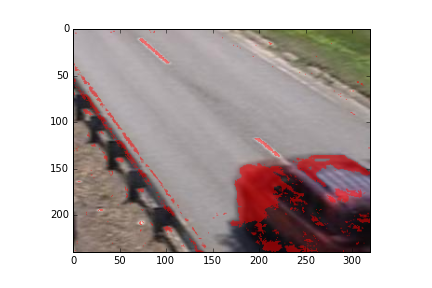

In [152]:
video = make_video(images[test_ind[:200]], y_3d_diag[:200])
video()

Использована модель смеси 3 трехмерных гауссиан с диагональными матрицами ковариаций для изображений в формате RGB.
Практически на всех кадрах присутствует значительное число ошибок первого рода, вызванных тряской камеры. Кроме того заметны и ошбики второго рода. Тем не менее получено значение AUC-ROC 95%

In [172]:
mean_3d_diag = np.zeros((w, h, 3), dtype=np.float32)
cov_3d_diag = np.zeros((w, h, 3, 3), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = train_img[:, x, y, :]                
        _, m, c, _ = EM.EM(X, 1, diag_cov=True)
        
        mean_3d_diag[x, y, :] = m
        cov_3d_diag[x, y, :, :] = c
    print('.', end='')

................................................................................................................................................................................................................................................

In [173]:
cov_3d_diag[:, :, np.arange(3), np.arange(3)] = np.maximum(cov_3d_diag[:, :, np.arange(3), np.arange(3)], 2)

In [175]:
p_3d_diag = np.zeros((test_img.shape[0], w, h), dtype=np.float32)
for x in range(w):
    for y in range(h):
        X = test_img[:, x, y, :]
        p_3d_diag[:, x, y] = -EM.logpdf(X, mean_3d_diag[x, y], cov_3d_diag[x, y], diag_cov=True)
    print('.', end='')

................................................................................................................................................................................................................................................

In [182]:
y_3d_diag = p_3d_diag > 30

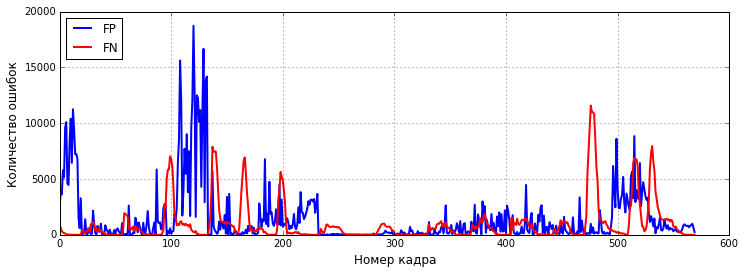

In [184]:
FP_3d_diag = np.sum(np.logical_and(static[test_ind], y_3d_diag), axis=(1, 2))
FN_3d_diag = np.sum(np.logical_and(motion[test_ind], np.logical_not(y_3d_diag)), axis=(1, 2))
plt.figure(figsize=(12, 4))
plt.plot(np.arange(test_ind.size), FP_3d_diag, 'b-', linewidth=2, label='FP')
plt.plot(np.arange(test_ind.size), FN_3d_diag, 'r-', linewidth=2, label='FN')
plt.legend(loc=2)
plt.xlabel('Номер кадра', fontsize=12)
plt.ylabel('Количество ошибок', fontsize=12)
plt.grid()
plt.show()

In [185]:
msk = np.logical_or(motion, static)[test_ind]
fpr_3d_diag, tpr_3d_diag, _ = roc_curve(motion[test_ind][msk], p_3d_diag[msk])

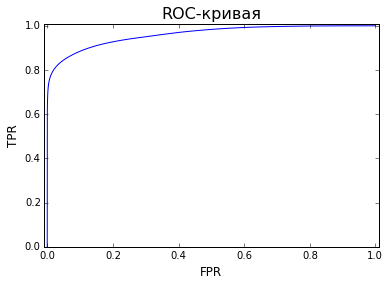

AUC-ROC: 0.960024216206


In [186]:
plt.plot(fpr_3d_diag, tpr_3d_diag)
plt.xlim([-0.01, 1.01])
plt.ylim([0.0, 1.01])
plt.title('ROC-кривая', fontsize=16)
plt.xlabel('FPR', fontsize=12)
plt.ylabel('TPR', fontsize=12)
plt.show()
print('AUC-ROC:', auc(fpr_3d_diag, tpr_3d_diag))


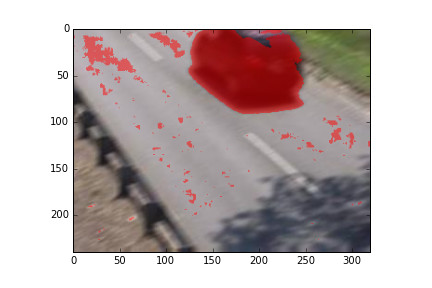
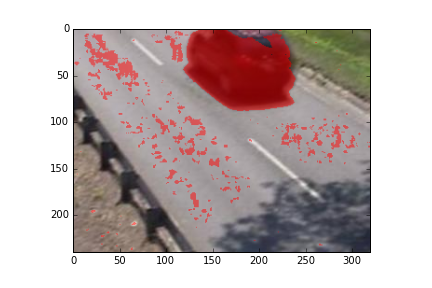
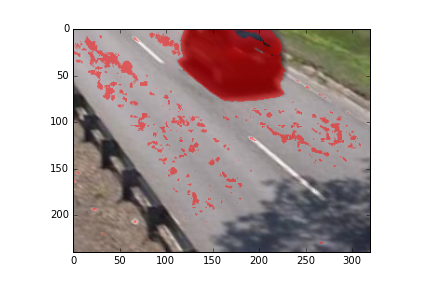
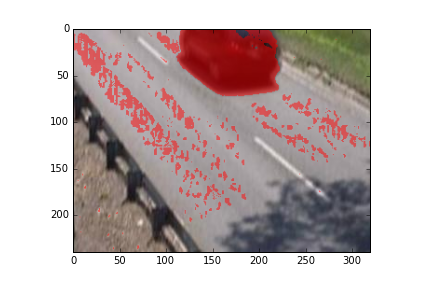
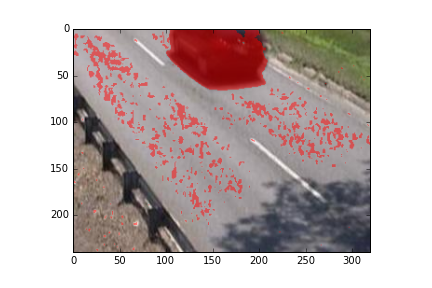
...
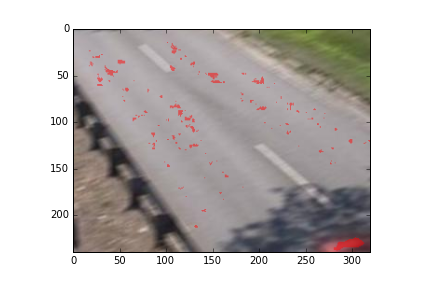
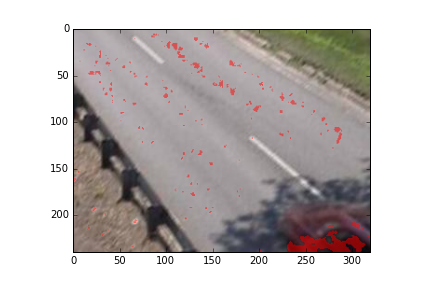
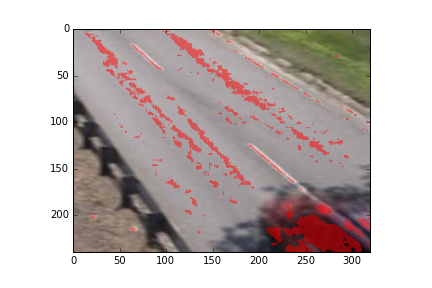
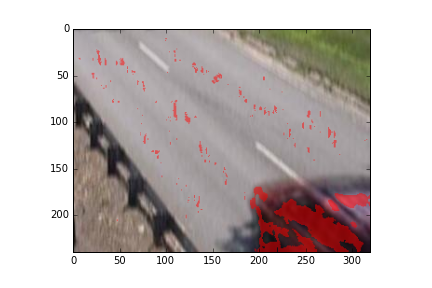
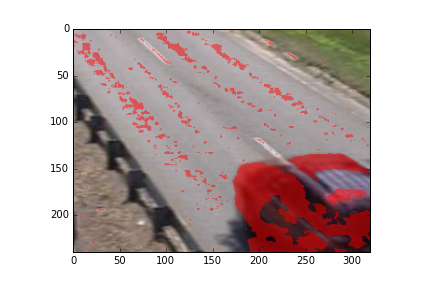

In [187]:
video = make_video(images[test_ind[:200]], y_3d_diag[:200])
video()

Модель фона с одной гауссианой допускает гораздо больше ошибок 1 рода. Качество по метрике AUC-ROC для рассмотренных моделей практически не отличается.

---
### Выводы
По проделанной работе можно сделать следующие выводы:
 
* Моделирование фона смесью нормальных распределений оказывается весьма эффективным пожходом к задаче вычитания фона.
* Особую трудность представляет подбор пороговых значений и регуляризация стандартных отклонений для полученных распределений.
* В случаях наличия на видеопоследоваетльности дрейфа фона, следует применять адаптивную модель.
* Увеличение компонент в смеси может привести к улучшению результатов классификации, но при этом происходит увеличение времени работы и объем использованной памяти.